In [1]:
import os 
import numpy as np
from PIL import Image
from dataloader import Custom_loader
from model import Generator, Discriminator
from utils import train_gen, train_disc
import torch
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from tqdm import tqdm
import matplotlib.pyplot as plt
from torchvision import transforms
import cv2
import random
import os
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [2]:
data_folder = '/DATA/shrestha/midsem_project/P1_dataset_training/p1'
train_dataset = Custom_loader(data_folder) 
train_dataloader = DataLoader(train_dataset, batch_size=64, shuffle=True)

In [3]:
generator = Generator().to(device)
discriminator = Discriminator().to(device)
gen_weights_path = '/DATA/shrestha/midsem_project/P1_dataset_training/model_saved/face_gan.pth'
disc_weights_path = '/DATA/shrestha/midsem_project/P1_dataset_training/model_saved/dicriminator.pth'
generator.load_state_dict(torch.load(gen_weights_path))
discriminator.load_state_dict(torch.load(disc_weights_path))
generator.train()
discriminator.train()
EPOCHS = 100
gen_optimizer = torch.optim.Adam(generator.parameters(), lr=1e-5)
disc_optimizer = torch.optim.Adam(discriminator.parameters(), lr=1e-5)

In [4]:
import numpy as np
import matplotlib.pyplot as plt

def visualize_output(output):
    batch_size = output.shape[0]

    # Ensure that batch_size is at least 4 to select 4 random samples
    if batch_size >= 4:
        selected_indices = torch.randperm(batch_size)[:4]
    else:
        selected_indices = torch.arange(batch_size)  # Use all samples if batch_size < 4

    selected_samples = output[selected_indices]
    selected_samples = selected_samples.cpu().detach().numpy()
    selected_images = selected_samples.transpose(0, 2, 3, 1)

    fig, axes = plt.subplots(1, 4, figsize=(16, 4))  # Use 4 subplots
    for i, ax in enumerate(axes):
        ax.imshow((selected_images[i] * 255).astype(np.uint8))
        ax.axis('off')  # Disable axis
    plt.show()


EPOCH: 1


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.015209933742880821, Adversarial Generator loss: 0.7518723011016846, Cycle loss: 0.01097430381923914, Diversity loss: 0.10224908590316772, Discriminator loss: 1.3453351259231567


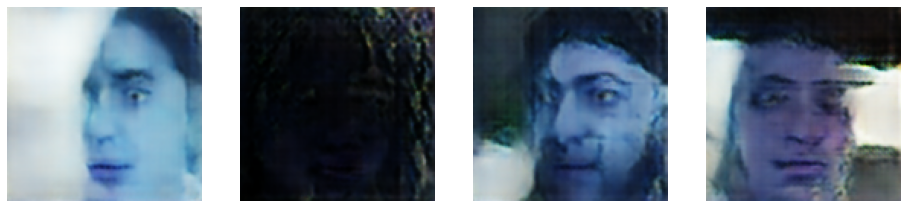

EPOCH: 2


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:03<00:00,  1.72batch/s]


Reconstruction loss: 0.013501765206456184, Adversarial Generator loss: 0.7351382374763489, Cycle loss: 0.010278169997036457, Diversity loss: 0.09994805604219437, Discriminator loss: 1.36170494556427


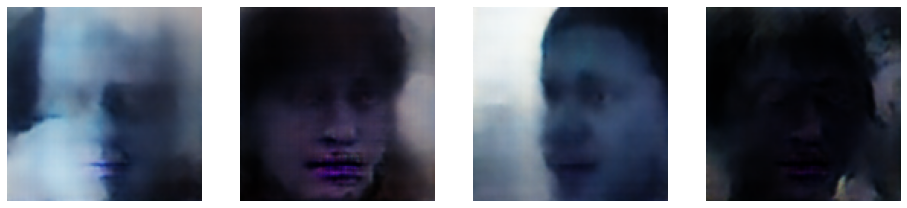

EPOCH: 3


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:10<00:00,  1.68batch/s]


Reconstruction loss: 0.011829128488898277, Adversarial Generator loss: 0.7345770597457886, Cycle loss: 0.009277967736124992, Diversity loss: 0.10010796040296555, Discriminator loss: 1.354357123374939


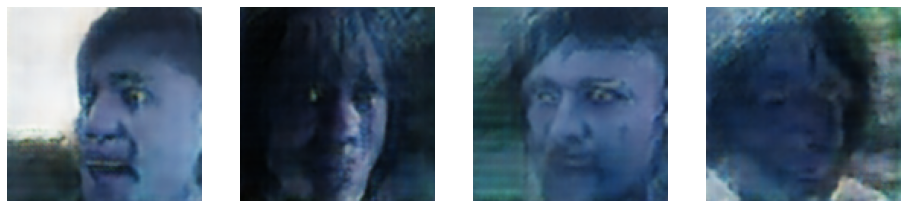

EPOCH: 4


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:05<00:00,  1.71batch/s]


Reconstruction loss: 0.011885173618793488, Adversarial Generator loss: 0.724510133266449, Cycle loss: 0.009253127500414848, Diversity loss: 0.10098326206207275, Discriminator loss: 1.3633555173873901


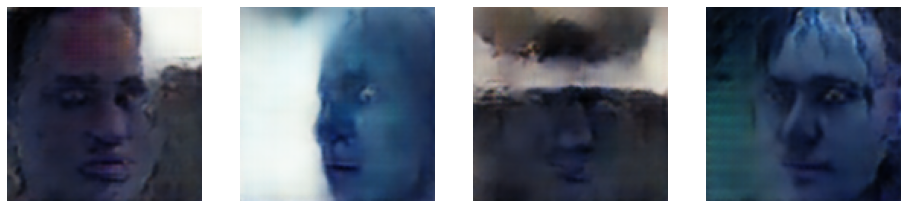

EPOCH: 5


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.010903934948146343, Adversarial Generator loss: 0.7291932702064514, Cycle loss: 0.008651317097246647, Diversity loss: 0.09938673675060272, Discriminator loss: 1.371200442314148


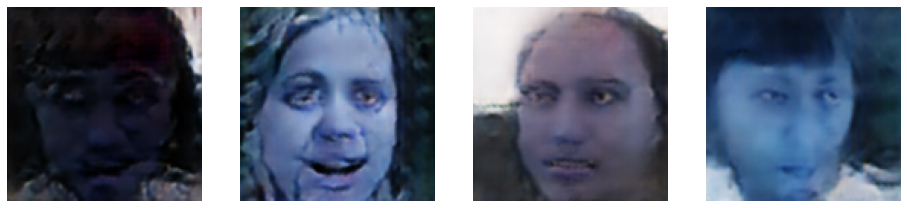

EPOCH: 6


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.011131133884191513, Adversarial Generator loss: 0.722216010093689, Cycle loss: 0.00849600974470377, Diversity loss: 0.1006186380982399, Discriminator loss: 1.373278021812439


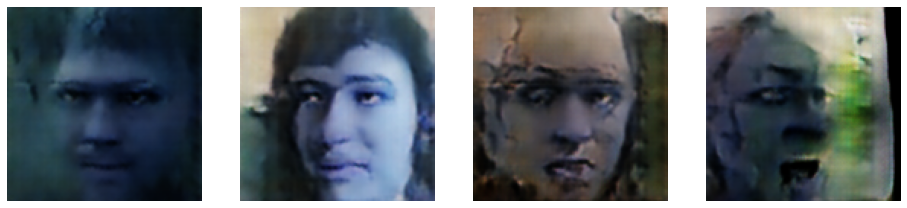

EPOCH: 7


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.011295229196548462, Adversarial Generator loss: 0.7186056971549988, Cycle loss: 0.00853056088089943, Diversity loss: 0.10098408907651901, Discriminator loss: 1.3754571676254272


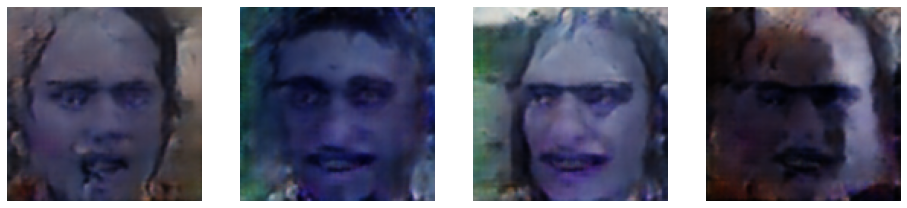

EPOCH: 8


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.70batch/s]


Reconstruction loss: 0.010956277139484882, Adversarial Generator loss: 0.7120634913444519, Cycle loss: 0.008467452600598335, Diversity loss: 0.10068003088235855, Discriminator loss: 1.3681389093399048


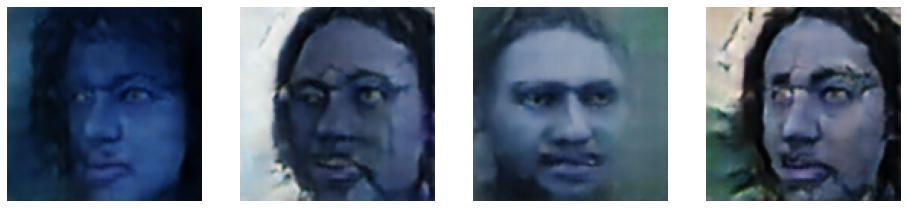

EPOCH: 9


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.010799395851790905, Adversarial Generator loss: 0.7244694232940674, Cycle loss: 0.008382800966501236, Diversity loss: 0.10007259994745255, Discriminator loss: 1.3731359243392944


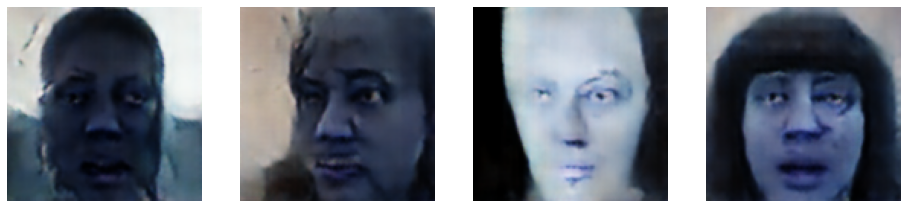

EPOCH: 10


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.011606014333665371, Adversarial Generator loss: 0.7102987766265869, Cycle loss: 0.008787724189460278, Diversity loss: 0.09979096055030823, Discriminator loss: 1.3679121732711792


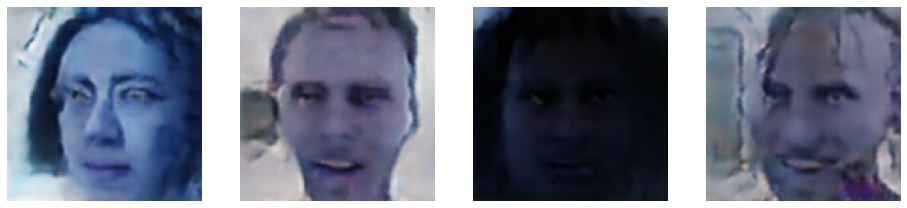

EPOCH: 11


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.011240193620324135, Adversarial Generator loss: 0.732384979724884, Cycle loss: 0.00885916966944933, Diversity loss: 0.0992286205291748, Discriminator loss: 1.3603821992874146


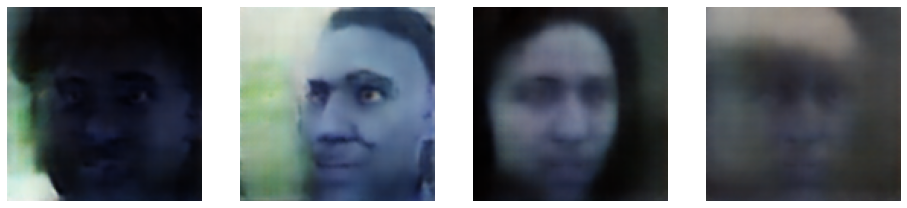

EPOCH: 12


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.011360593140125275, Adversarial Generator loss: 0.7208282947540283, Cycle loss: 0.008717880584299564, Diversity loss: 0.09853602945804596, Discriminator loss: 1.3612736463546753


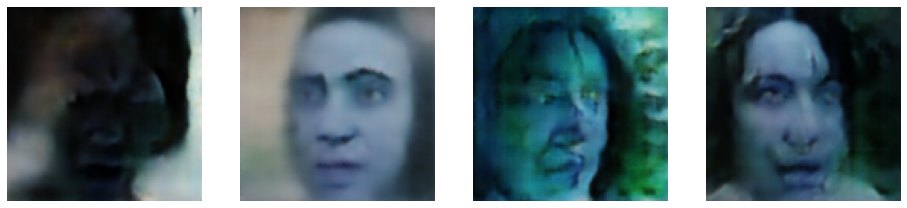

EPOCH: 13


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.011243223212659359, Adversarial Generator loss: 0.7391454577445984, Cycle loss: 0.008782043121755123, Diversity loss: 0.09985583275556564, Discriminator loss: 1.3636611700057983


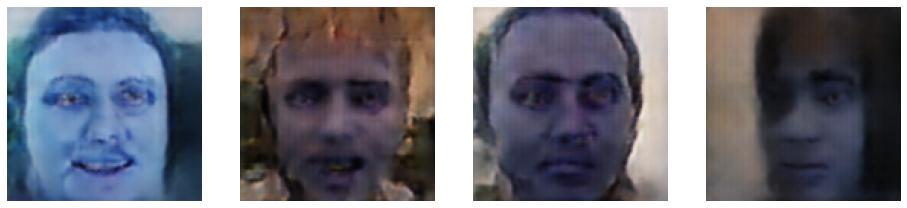

EPOCH: 14


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.01112242229282856, Adversarial Generator loss: 0.7254895567893982, Cycle loss: 0.008539344184100628, Diversity loss: 0.09925936907529831, Discriminator loss: 1.3691421747207642


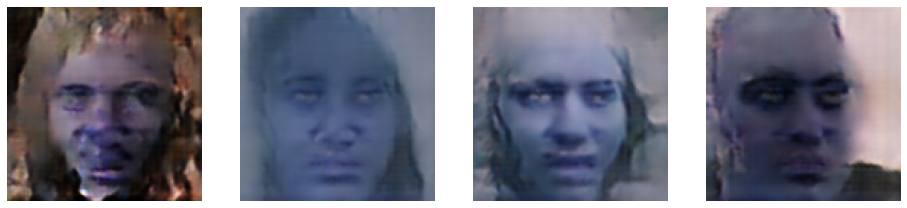

EPOCH: 15


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:10<00:00,  1.68batch/s]


Reconstruction loss: 0.011636988259851933, Adversarial Generator loss: 0.729979395866394, Cycle loss: 0.008861309848725796, Diversity loss: 0.09930766373872757, Discriminator loss: 1.3559906482696533


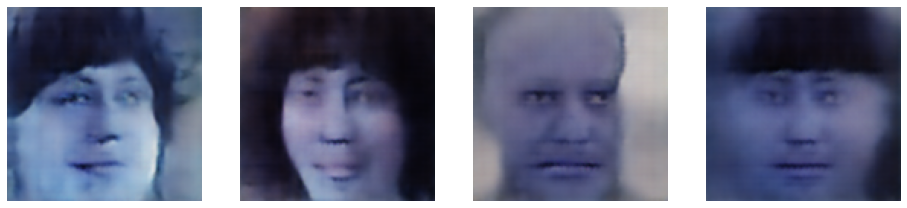

EPOCH: 16


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:11<00:00,  1.67batch/s]


Reconstruction loss: 0.011860180646181107, Adversarial Generator loss: 0.7351804971694946, Cycle loss: 0.008672820404171944, Diversity loss: 0.10012047737836838, Discriminator loss: 1.358591079711914


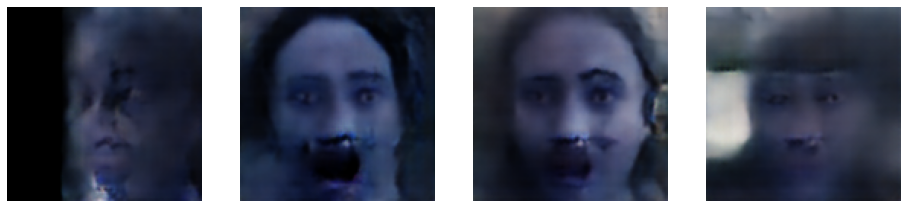

EPOCH: 17


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.012304903008043766, Adversarial Generator loss: 0.73086017370224, Cycle loss: 0.009092731401324272, Diversity loss: 0.09883557260036469, Discriminator loss: 1.3580604791641235


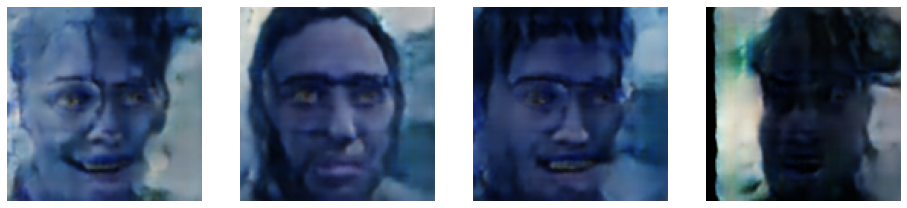

EPOCH: 18


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.013278267346322536, Adversarial Generator loss: 0.7482960224151611, Cycle loss: 0.009685520082712173, Diversity loss: 0.09817851334810257, Discriminator loss: 1.335439682006836


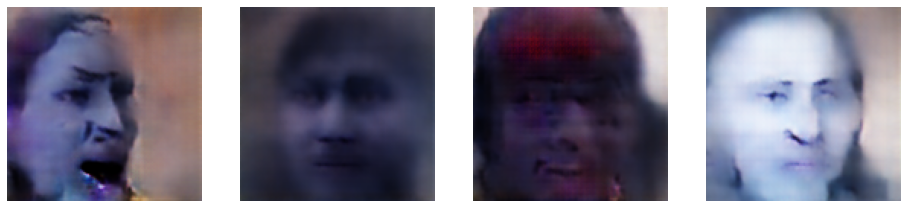

EPOCH: 19


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:10<00:00,  1.68batch/s]


Reconstruction loss: 0.012347220443189144, Adversarial Generator loss: 0.7682335376739502, Cycle loss: 0.0093163400888443, Diversity loss: 0.09959587454795837, Discriminator loss: 1.3335617780685425


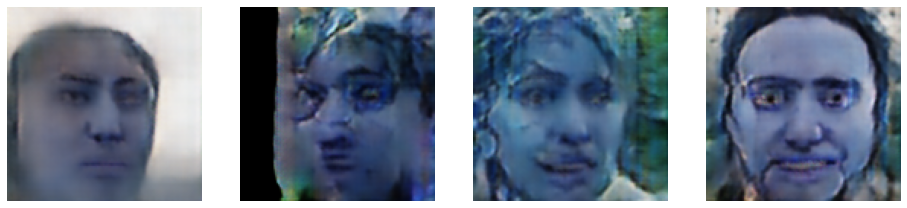

EPOCH: 20


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.012766796164214611, Adversarial Generator loss: 0.7721750140190125, Cycle loss: 0.00951161328703165, Diversity loss: 0.09837718307971954, Discriminator loss: 1.3203885555267334


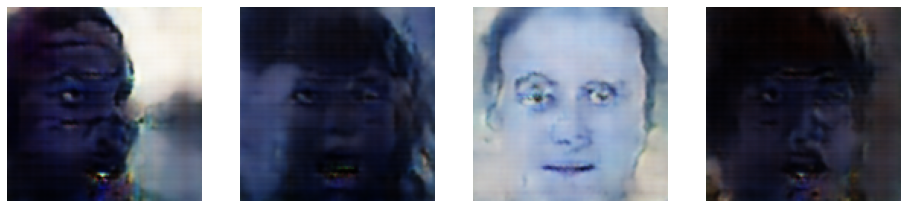

EPOCH: 21


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.70batch/s]


Reconstruction loss: 0.01302693784236908, Adversarial Generator loss: 0.7572105526924133, Cycle loss: 0.009643914178013802, Diversity loss: 0.0991106927394867, Discriminator loss: 1.3173255920410156


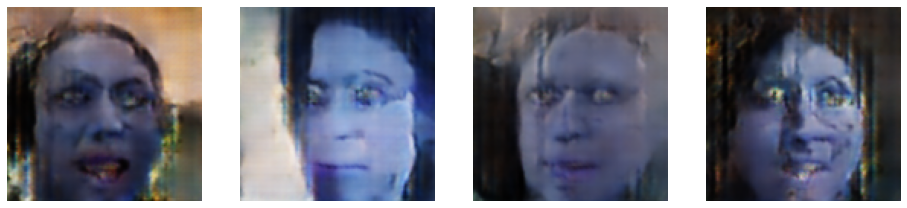

EPOCH: 22


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.015575329773128033, Adversarial Generator loss: 0.8420613408088684, Cycle loss: 0.011474975384771824, Diversity loss: 0.09791185706853867, Discriminator loss: 1.265877366065979


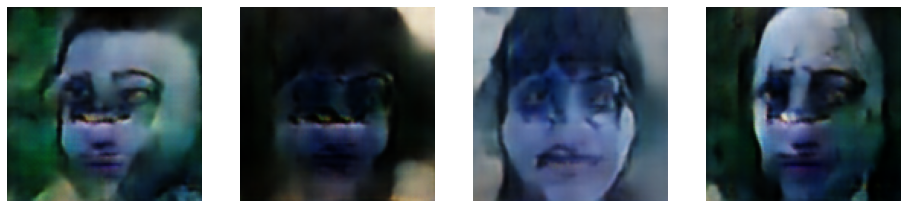

EPOCH: 23


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.016015207394957542, Adversarial Generator loss: 0.8573999404907227, Cycle loss: 0.011846200563013554, Diversity loss: 0.09831283241510391, Discriminator loss: 1.2417418956756592


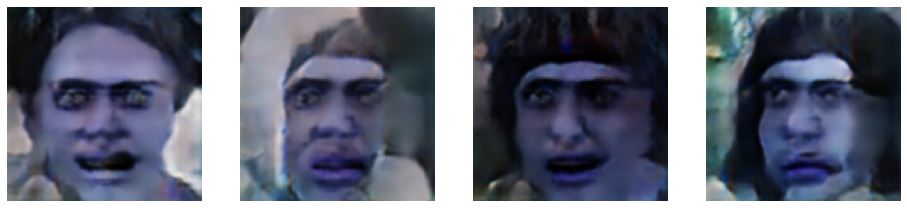

EPOCH: 24


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.018376994878053665, Adversarial Generator loss: 0.9805864691734314, Cycle loss: 0.013973960652947426, Diversity loss: 0.09595365822315216, Discriminator loss: 1.1589525938034058


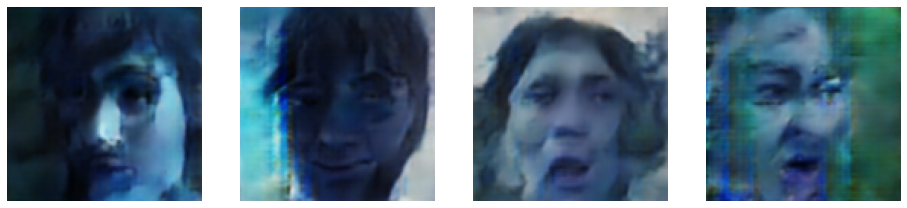

EPOCH: 25


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.0206536203622818, Adversarial Generator loss: 1.0985400676727295, Cycle loss: 0.015322842635214329, Diversity loss: 0.09631205350160599, Discriminator loss: 1.098396897315979


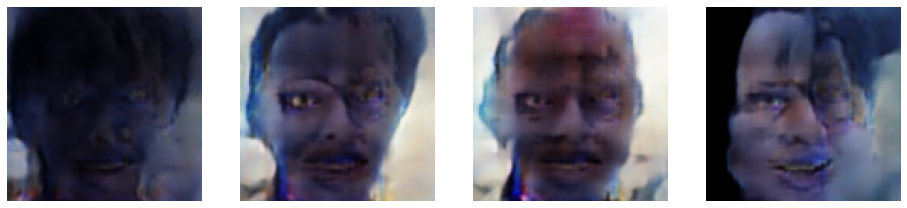

EPOCH: 26


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.020801518112421036, Adversarial Generator loss: 1.243250846862793, Cycle loss: 0.015361566096544266, Diversity loss: 0.09593752771615982, Discriminator loss: 0.9960659742355347


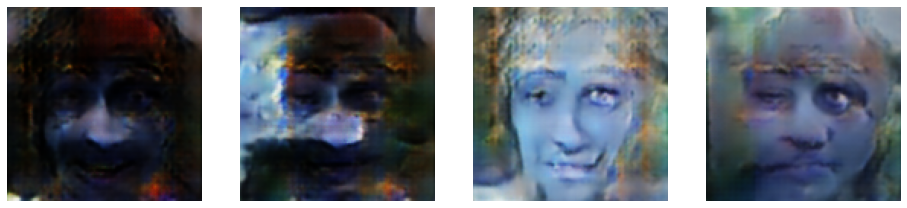

EPOCH: 27


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.023485084995627403, Adversarial Generator loss: 1.3769294023513794, Cycle loss: 0.017069075256586075, Diversity loss: 0.09531430155038834, Discriminator loss: 0.9230377078056335


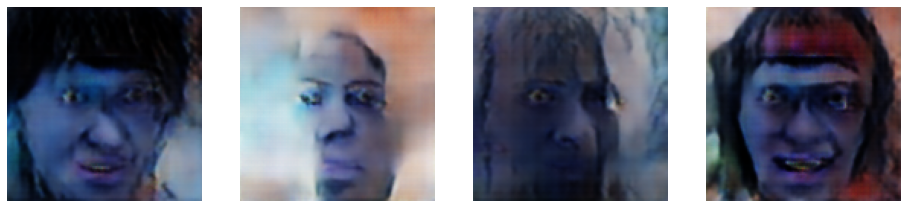

EPOCH: 28


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.70batch/s]


Reconstruction loss: 0.024386117234826088, Adversarial Generator loss: 1.6333905458450317, Cycle loss: 0.017353462055325508, Diversity loss: 0.09567436575889587, Discriminator loss: 0.7733091711997986


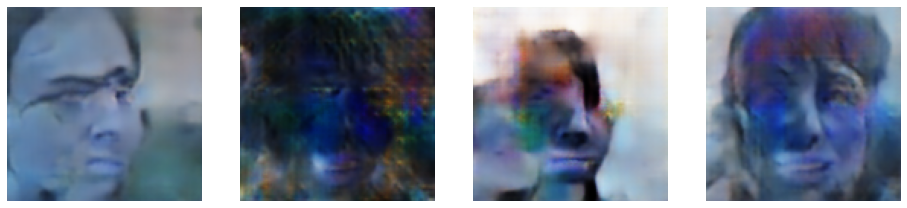

EPOCH: 29


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:05<00:00,  1.70batch/s]


Reconstruction loss: 0.025911981239914894, Adversarial Generator loss: 2.039283037185669, Cycle loss: 0.019763166084885597, Diversity loss: 0.09451446682214737, Discriminator loss: 0.6274299621582031


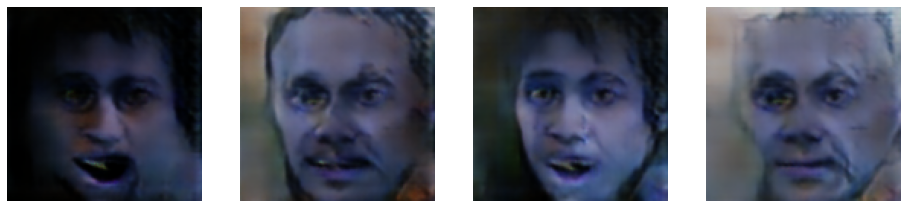

EPOCH: 30


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.03051355667412281, Adversarial Generator loss: 2.1529483795166016, Cycle loss: 0.022298892959952354, Diversity loss: 0.09567388892173767, Discriminator loss: 0.6178381443023682


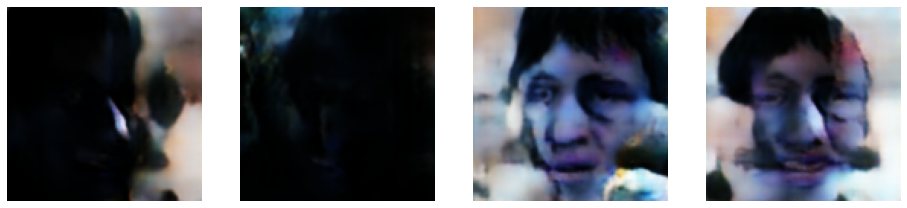

EPOCH: 31


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:04<00:00,  1.71batch/s]


Reconstruction loss: 0.030374538153409958, Adversarial Generator loss: 2.3483805656433105, Cycle loss: 0.02306182123720646, Diversity loss: 0.09529099613428116, Discriminator loss: 0.5414865612983704


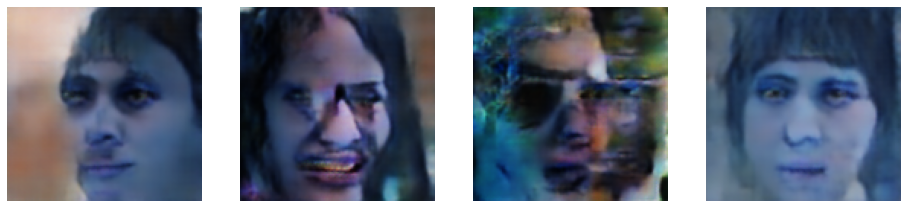

EPOCH: 32


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:12<00:00,  1.66batch/s]


Reconstruction loss: 0.030388908460736275, Adversarial Generator loss: 2.498112201690674, Cycle loss: 0.021564964205026627, Diversity loss: 0.09434356540441513, Discriminator loss: 0.4783194959163666


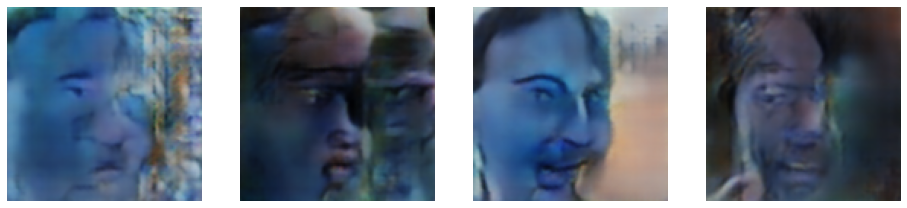

EPOCH: 33


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.0317935086786747, Adversarial Generator loss: 2.5688464641571045, Cycle loss: 0.02281392551958561, Diversity loss: 0.09307994693517685, Discriminator loss: 0.46813830733299255


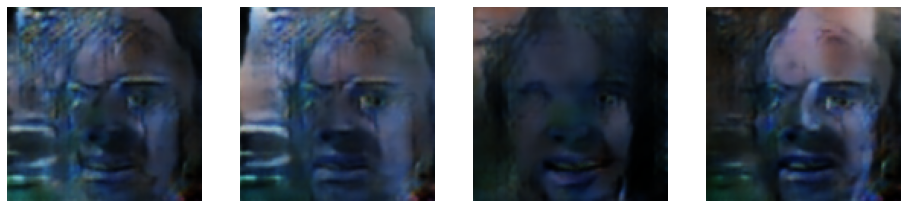

EPOCH: 34


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.034743938595056534, Adversarial Generator loss: 2.7607619762420654, Cycle loss: 0.02460973523557186, Diversity loss: 0.09283129870891571, Discriminator loss: 0.4355655610561371


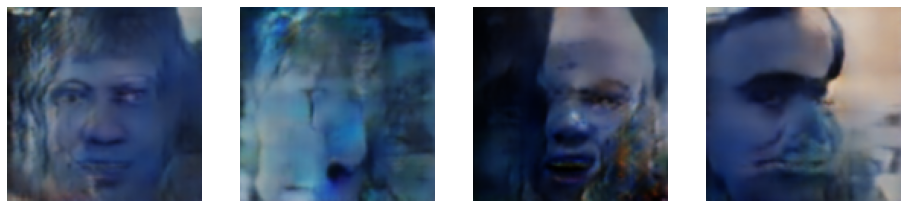

EPOCH: 35


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:04<00:00,  1.71batch/s]


Reconstruction loss: 0.03480546176433563, Adversarial Generator loss: 2.9128942489624023, Cycle loss: 0.023580988869071007, Diversity loss: 0.09261301904916763, Discriminator loss: 0.390510618686676


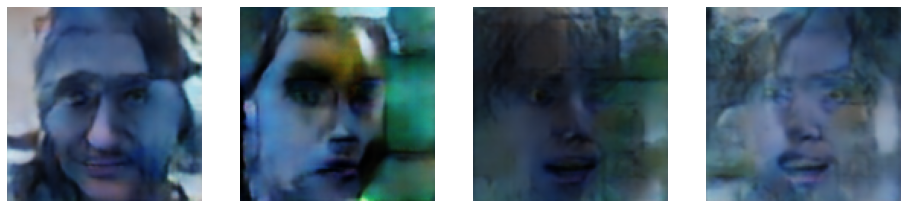

EPOCH: 36


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.037149738520383835, Adversarial Generator loss: 2.9519028663635254, Cycle loss: 0.023699766024947166, Diversity loss: 0.09228138625621796, Discriminator loss: 0.3985744118690491


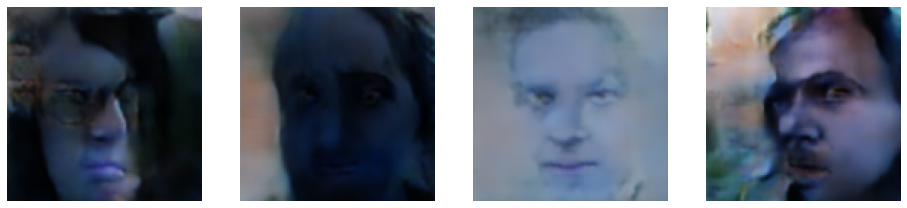

EPOCH: 37


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:10<00:00,  1.68batch/s]


Reconstruction loss: 0.03898553177714348, Adversarial Generator loss: 2.964723825454712, Cycle loss: 0.023568006232380867, Diversity loss: 0.0898304209113121, Discriminator loss: 0.3739822506904602


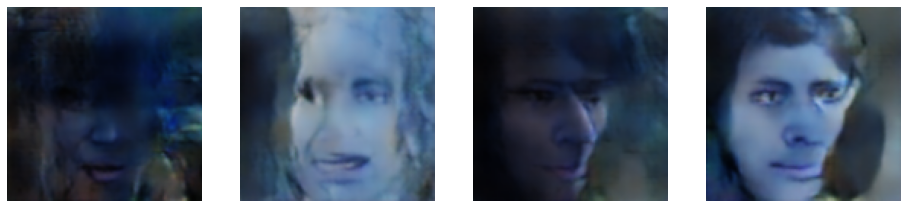

EPOCH: 38


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.038021087646484375, Adversarial Generator loss: 2.940636396408081, Cycle loss: 0.0230084415525198, Diversity loss: 0.09145493805408478, Discriminator loss: 0.3888138234615326


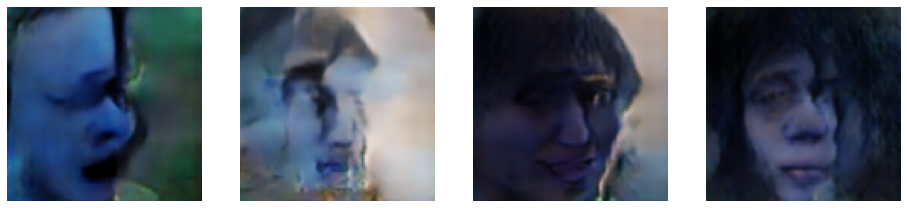

EPOCH: 39


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:05<00:00,  1.70batch/s]


Reconstruction loss: 0.03730955347418785, Adversarial Generator loss: 2.9524593353271484, Cycle loss: 0.02351370081305504, Diversity loss: 0.091656394302845, Discriminator loss: 0.3730836510658264


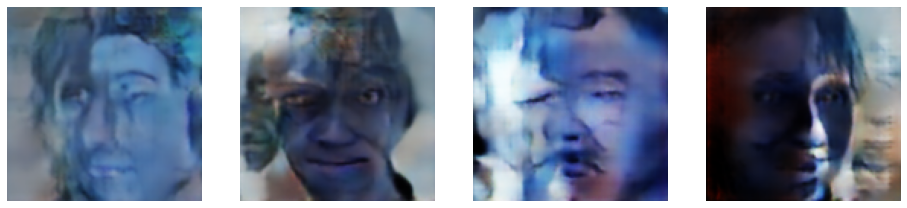

EPOCH: 40


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.70batch/s]


Reconstruction loss: 0.038425516337156296, Adversarial Generator loss: 3.03627347946167, Cycle loss: 0.023298664018511772, Diversity loss: 0.08884363621473312, Discriminator loss: 0.37329742312431335


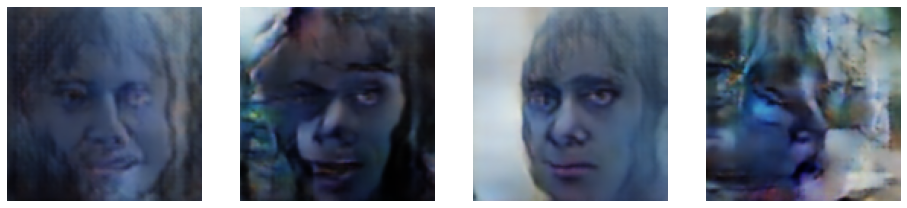

EPOCH: 41


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:05<00:00,  1.71batch/s]


Reconstruction loss: 0.037725403904914856, Adversarial Generator loss: 2.8589978218078613, Cycle loss: 0.02310325764119625, Diversity loss: 0.08991467952728271, Discriminator loss: 0.4082130789756775


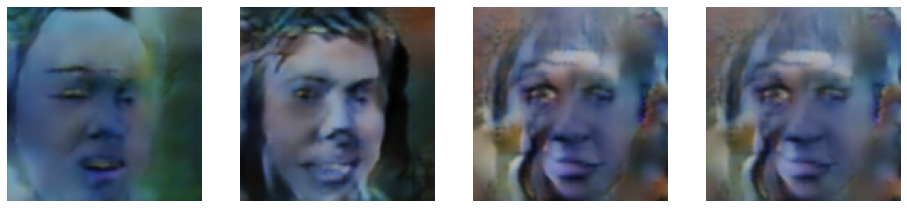

EPOCH: 42


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.03946049511432648, Adversarial Generator loss: 2.8207390308380127, Cycle loss: 0.02263299748301506, Diversity loss: 0.09247829020023346, Discriminator loss: 0.40312784910202026


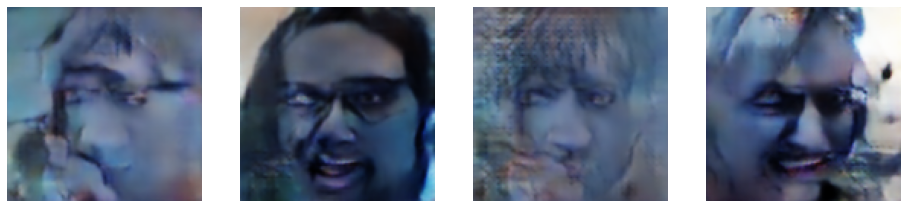

EPOCH: 43


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.038455426692962646, Adversarial Generator loss: 2.8664872646331787, Cycle loss: 0.022891508415341377, Diversity loss: 0.09240956604480743, Discriminator loss: 0.4092046320438385


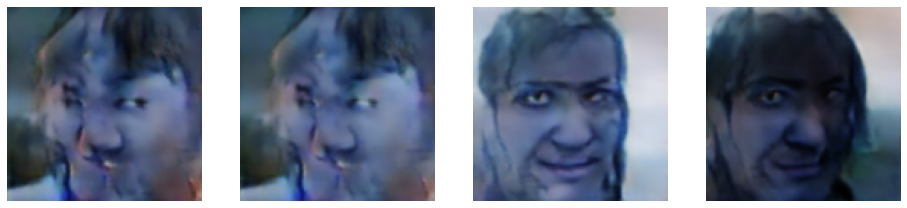

EPOCH: 44


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.03820984065532684, Adversarial Generator loss: 2.794107675552368, Cycle loss: 0.022973675280809402, Diversity loss: 0.09210535883903503, Discriminator loss: 0.4114927053451538


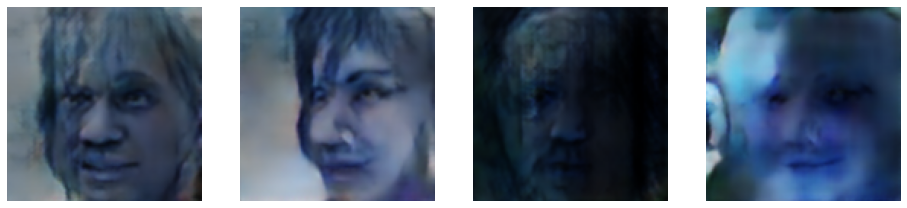

EPOCH: 45


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.0369279645383358, Adversarial Generator loss: 2.7867188453674316, Cycle loss: 0.022706862539052963, Diversity loss: 0.09283316135406494, Discriminator loss: 0.41426780819892883


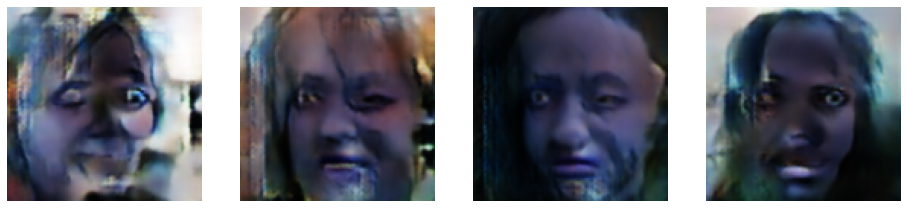

EPOCH: 46


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.03723942115902901, Adversarial Generator loss: 2.844977617263794, Cycle loss: 0.022488970309495926, Diversity loss: 0.09040869027376175, Discriminator loss: 0.3986302316188812


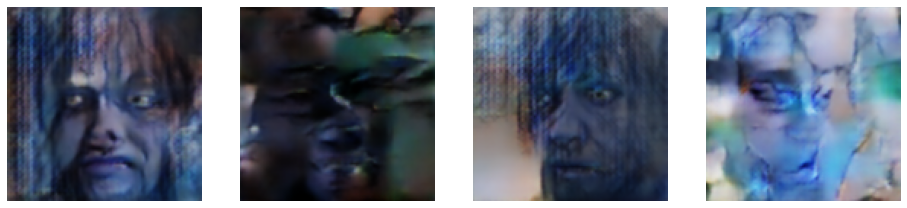

EPOCH: 47


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:04<00:00,  1.71batch/s]


Reconstruction loss: 0.03783828020095825, Adversarial Generator loss: 2.7461025714874268, Cycle loss: 0.023975703865289688, Diversity loss: 0.09076106548309326, Discriminator loss: 0.4353051483631134


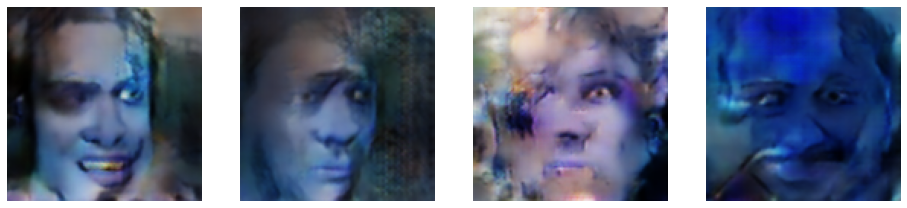

EPOCH: 48


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.70batch/s]


Reconstruction loss: 0.03679350018501282, Adversarial Generator loss: 2.6808531284332275, Cycle loss: 0.022637763991951942, Diversity loss: 0.08963034301996231, Discriminator loss: 0.4488336741924286


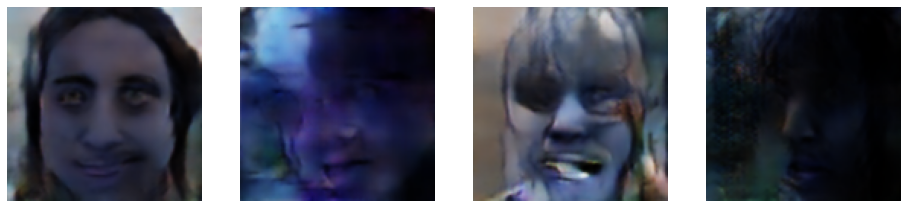

EPOCH: 49


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.037703294306993484, Adversarial Generator loss: 2.717855930328369, Cycle loss: 0.022465500980615616, Diversity loss: 0.09060760587453842, Discriminator loss: 0.4402846097946167


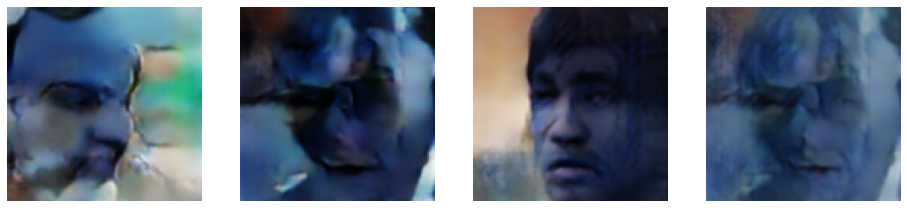

EPOCH: 50


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.03840641677379608, Adversarial Generator loss: 2.6558821201324463, Cycle loss: 0.022405896335840225, Diversity loss: 0.09106047451496124, Discriminator loss: 0.4572117030620575


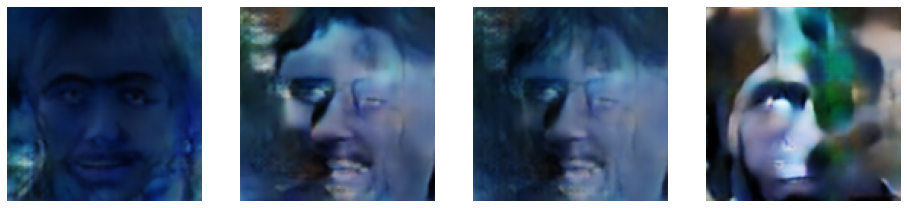

EPOCH: 51


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.70batch/s]


Reconstruction loss: 0.037901755422353745, Adversarial Generator loss: 2.597008228302002, Cycle loss: 0.022461432963609695, Diversity loss: 0.08915338665246964, Discriminator loss: 0.46801823377609253


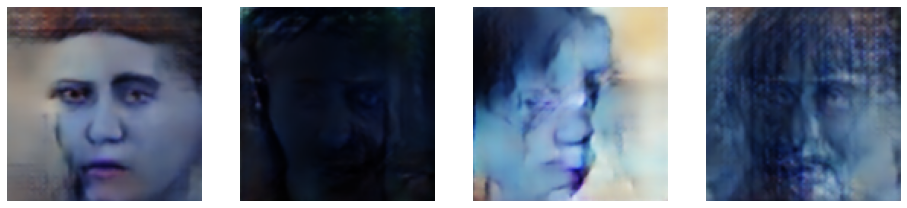

EPOCH: 52


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.037676066160202026, Adversarial Generator loss: 2.6993186473846436, Cycle loss: 0.022950710728764534, Diversity loss: 0.09207777678966522, Discriminator loss: 0.44231119751930237


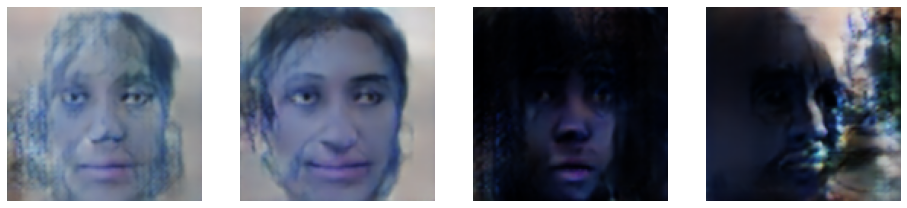

EPOCH: 53


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:05<00:00,  1.71batch/s]


Reconstruction loss: 0.03860776126384735, Adversarial Generator loss: 2.6646084785461426, Cycle loss: 0.02213129773736, Diversity loss: 0.09140507876873016, Discriminator loss: 0.45432138442993164


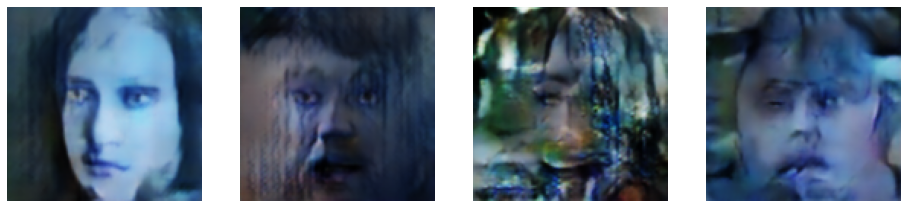

EPOCH: 54


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:05<00:00,  1.70batch/s]


Reconstruction loss: 0.036689646542072296, Adversarial Generator loss: 2.701443672180176, Cycle loss: 0.02171207219362259, Diversity loss: 0.0907597541809082, Discriminator loss: 0.4440113604068756


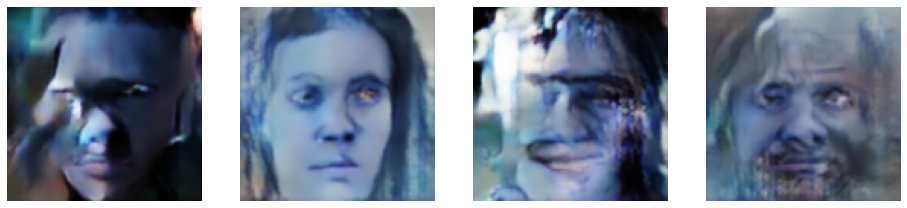

EPOCH: 55


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.03921876475214958, Adversarial Generator loss: 2.773392915725708, Cycle loss: 0.022398725152015686, Diversity loss: 0.09285341948270798, Discriminator loss: 0.4406130015850067


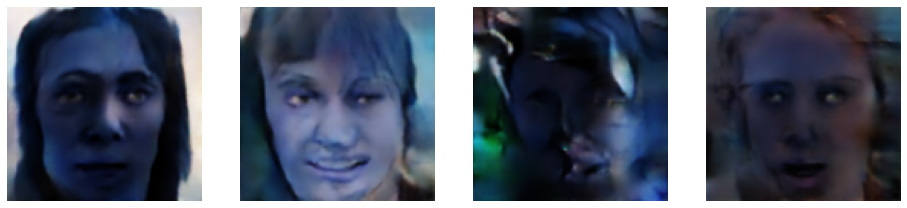

EPOCH: 56


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.70batch/s]


Reconstruction loss: 0.03903797268867493, Adversarial Generator loss: 2.608325481414795, Cycle loss: 0.02173641510307789, Diversity loss: 0.08813982456922531, Discriminator loss: 0.47018277645111084


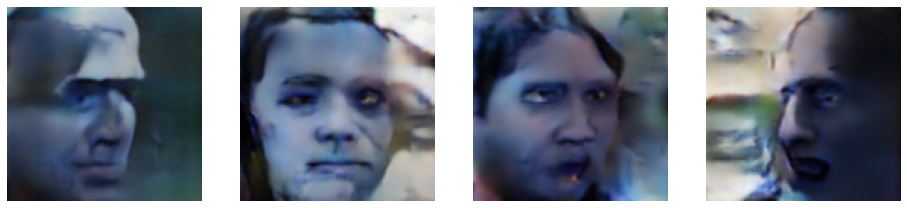

EPOCH: 57


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.038488294929265976, Adversarial Generator loss: 2.6564955711364746, Cycle loss: 0.02249775268137455, Diversity loss: 0.09139988571405411, Discriminator loss: 0.46339088678359985


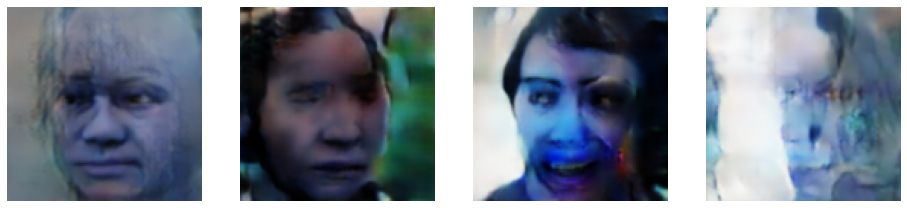

EPOCH: 58


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.0371268093585968, Adversarial Generator loss: 2.8581717014312744, Cycle loss: 0.022259652614593506, Diversity loss: 0.09052104502916336, Discriminator loss: 0.42021316289901733


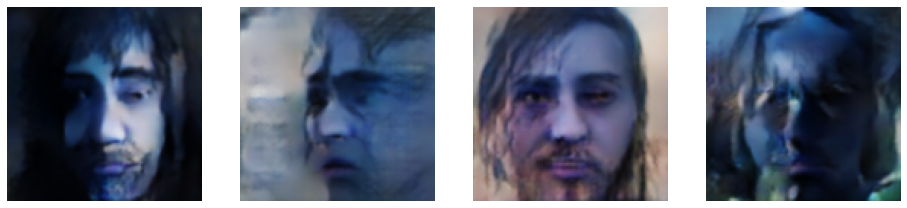

EPOCH: 59


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.03816179558634758, Adversarial Generator loss: 2.813145637512207, Cycle loss: 0.02272827737033367, Diversity loss: 0.09185043722391129, Discriminator loss: 0.4341745972633362


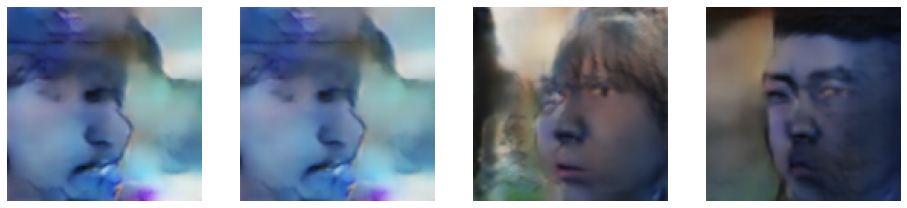

EPOCH: 60


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.03803958371281624, Adversarial Generator loss: 2.820826768875122, Cycle loss: 0.022287985309958458, Diversity loss: 0.08944617956876755, Discriminator loss: 0.4293575882911682


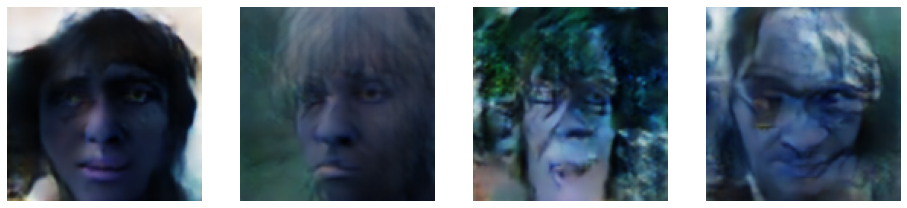

EPOCH: 61


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.69batch/s]


Reconstruction loss: 0.03798937425017357, Adversarial Generator loss: 2.897385835647583, Cycle loss: 0.022050851956009865, Diversity loss: 0.0890314057469368, Discriminator loss: 0.41682735085487366


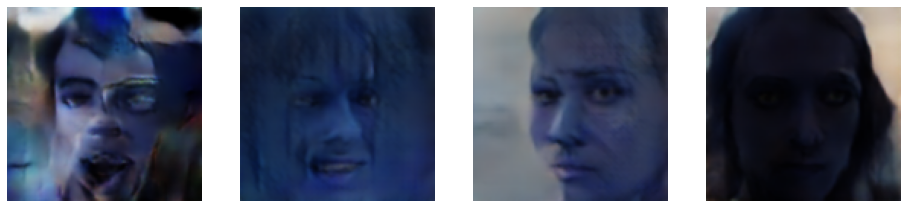

EPOCH: 62


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.03713507577776909, Adversarial Generator loss: 2.9270267486572266, Cycle loss: 0.02213292382657528, Diversity loss: 0.0910024419426918, Discriminator loss: 0.4063275456428528


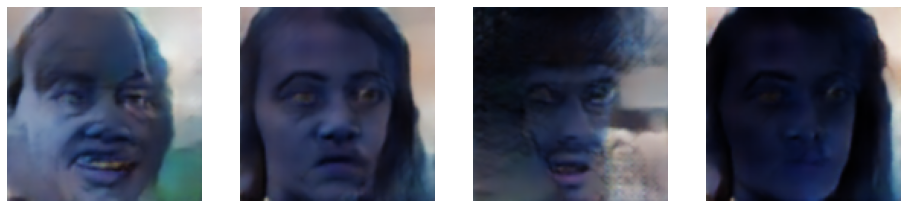

EPOCH: 63


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.03676673769950867, Adversarial Generator loss: 2.826352119445801, Cycle loss: 0.021815722808241844, Diversity loss: 0.09185507893562317, Discriminator loss: 0.4298197627067566


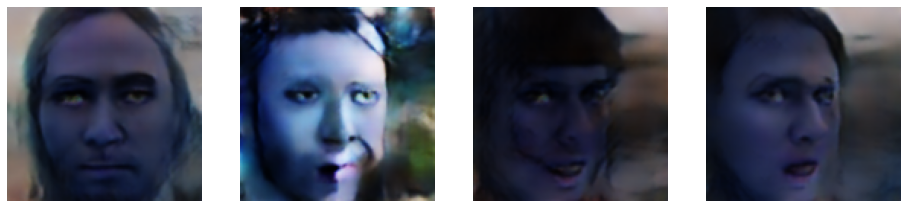

EPOCH: 64


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:11<00:00,  1.67batch/s]


Reconstruction loss: 0.03648374229669571, Adversarial Generator loss: 2.893167495727539, Cycle loss: 0.02215738222002983, Diversity loss: 0.08916735649108887, Discriminator loss: 0.4115176498889923


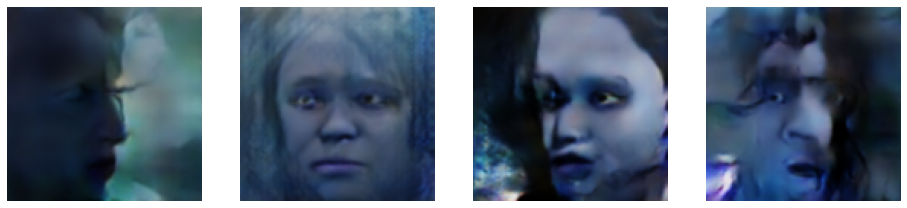

EPOCH: 65


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:11<00:00,  1.67batch/s]


Reconstruction loss: 0.03747247904539108, Adversarial Generator loss: 2.867572546005249, Cycle loss: 0.02217101864516735, Diversity loss: 0.08917978405952454, Discriminator loss: 0.42747679352760315


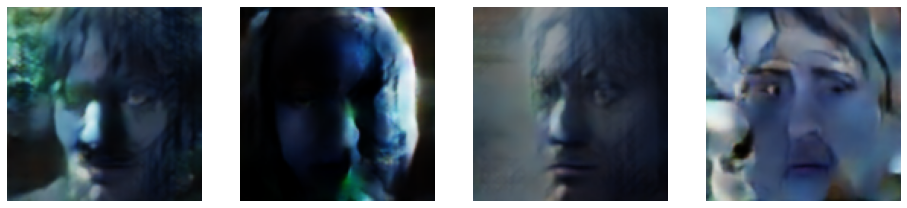

EPOCH: 66


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.039745084941387177, Adversarial Generator loss: 2.8331050872802734, Cycle loss: 0.022410836070775986, Diversity loss: 0.08893726021051407, Discriminator loss: 0.42939484119415283


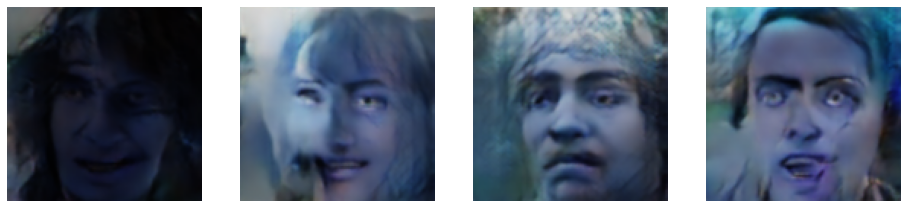

EPOCH: 67


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.037435147911310196, Adversarial Generator loss: 2.8544974327087402, Cycle loss: 0.021821200847625732, Diversity loss: 0.08933895081281662, Discriminator loss: 0.4314616620540619


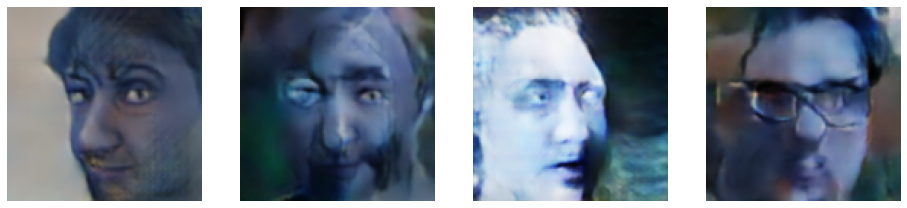

EPOCH: 68


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.039054546505212784, Adversarial Generator loss: 2.8929696083068848, Cycle loss: 0.02240007370710373, Diversity loss: 0.0888562873005867, Discriminator loss: 0.42525866627693176


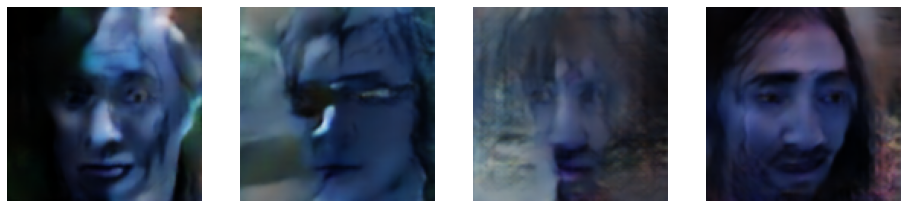

EPOCH: 69


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:10<00:00,  1.68batch/s]


Reconstruction loss: 0.037438105791807175, Adversarial Generator loss: 2.9501826763153076, Cycle loss: 0.022323118522763252, Diversity loss: 0.09170210361480713, Discriminator loss: 0.40970733761787415


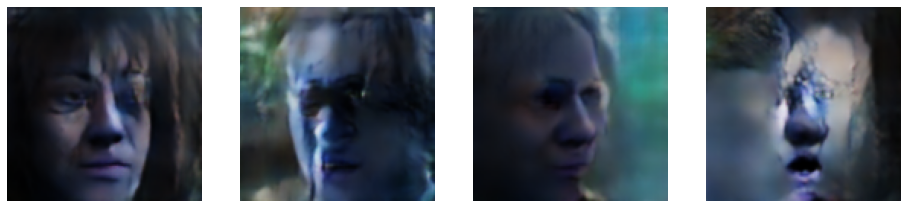

EPOCH: 70


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:10<00:00,  1.68batch/s]


Reconstruction loss: 0.03570404648780823, Adversarial Generator loss: 2.9174692630767822, Cycle loss: 0.02228737063705921, Diversity loss: 0.09051934629678726, Discriminator loss: 0.4182724058628082


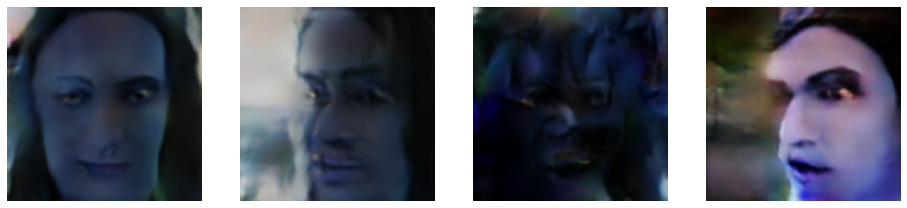

EPOCH: 71


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.03668984770774841, Adversarial Generator loss: 2.9793288707733154, Cycle loss: 0.023109862580895424, Diversity loss: 0.09124364703893661, Discriminator loss: 0.4143480658531189


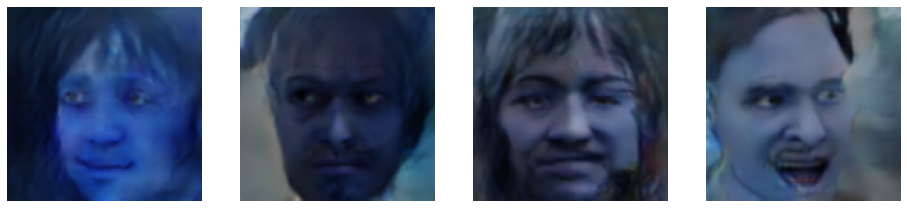

EPOCH: 72


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:10<00:00,  1.68batch/s]


Reconstruction loss: 0.03778309002518654, Adversarial Generator loss: 2.9860517978668213, Cycle loss: 0.023172566667199135, Diversity loss: 0.09205154329538345, Discriminator loss: 0.41199401021003723


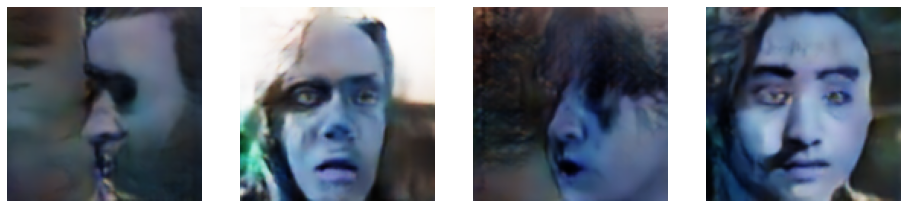

EPOCH: 73


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:11<00:00,  1.67batch/s]


Reconstruction loss: 0.03606324642896652, Adversarial Generator loss: 2.902658224105835, Cycle loss: 0.022271553054451942, Diversity loss: 0.09072920680046082, Discriminator loss: 0.4227432310581207


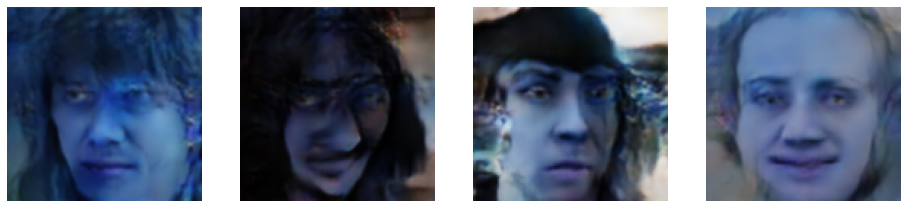

EPOCH: 74


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.03775624558329582, Adversarial Generator loss: 2.944844961166382, Cycle loss: 0.022944532334804535, Diversity loss: 0.09087730944156647, Discriminator loss: 0.42033088207244873


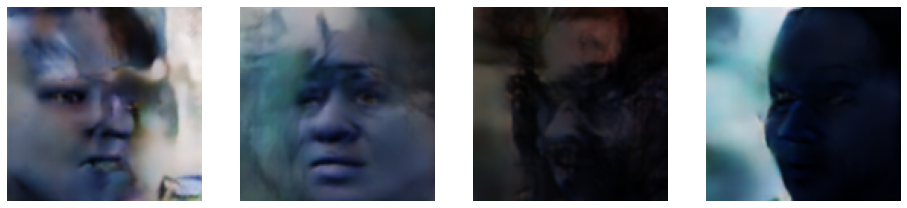

EPOCH: 75


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:10<00:00,  1.68batch/s]


Reconstruction loss: 0.03682567924261093, Adversarial Generator loss: 2.971576452255249, Cycle loss: 0.022908734157681465, Diversity loss: 0.09137297421693802, Discriminator loss: 0.40970733761787415


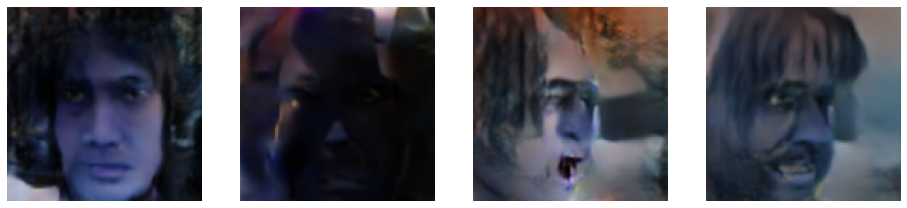

EPOCH: 76


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.03719913959503174, Adversarial Generator loss: 2.9568045139312744, Cycle loss: 0.022675994783639908, Diversity loss: 0.09237728267908096, Discriminator loss: 0.41820600628852844


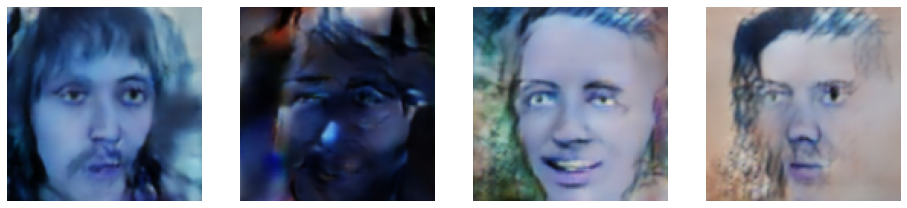

EPOCH: 77


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.69batch/s]


Reconstruction loss: 0.03812841325998306, Adversarial Generator loss: 2.8507182598114014, Cycle loss: 0.02230050414800644, Diversity loss: 0.09117899090051651, Discriminator loss: 0.44873759150505066


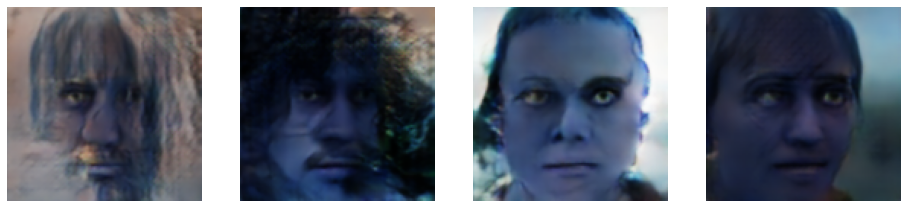

EPOCH: 78


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:11<00:00,  1.67batch/s]


Reconstruction loss: 0.03768109530210495, Adversarial Generator loss: 2.887136459350586, Cycle loss: 0.021729664877057076, Diversity loss: 0.08931009471416473, Discriminator loss: 0.42466968297958374


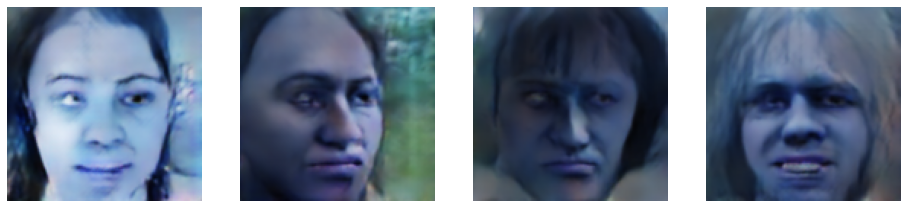

EPOCH: 79


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.03799690678715706, Adversarial Generator loss: 2.9388186931610107, Cycle loss: 0.021897193044424057, Diversity loss: 0.08949623256921768, Discriminator loss: 0.43087542057037354


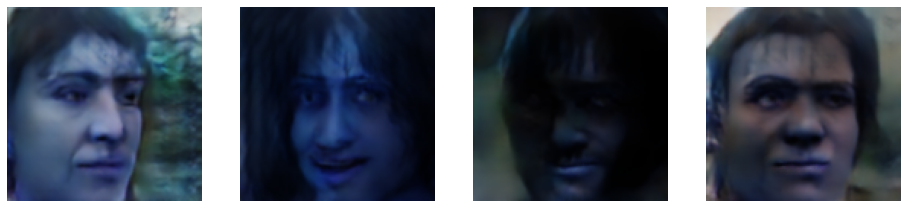

EPOCH: 80


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.037051957100629807, Adversarial Generator loss: 3.006544828414917, Cycle loss: 0.022060897201299667, Diversity loss: 0.09155367314815521, Discriminator loss: 0.42017170786857605


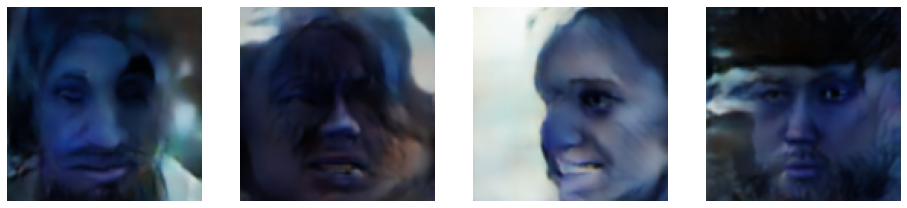

EPOCH: 81


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.69batch/s]


Reconstruction loss: 0.03696408122777939, Adversarial Generator loss: 3.013230562210083, Cycle loss: 0.0225728377699852, Diversity loss: 0.09092544764280319, Discriminator loss: 0.4265793263912201


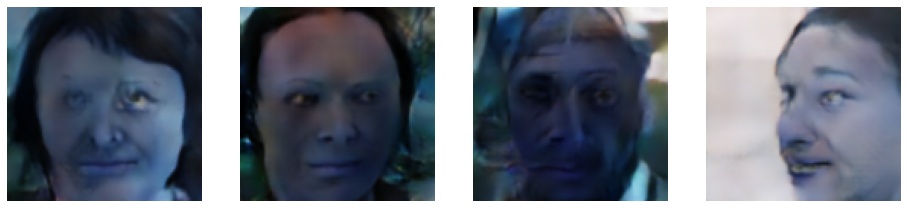

EPOCH: 82


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:10<00:00,  1.68batch/s]


Reconstruction loss: 0.03607241436839104, Adversarial Generator loss: 2.9607739448547363, Cycle loss: 0.021215895190835, Diversity loss: 0.09020175039768219, Discriminator loss: 0.42268648743629456


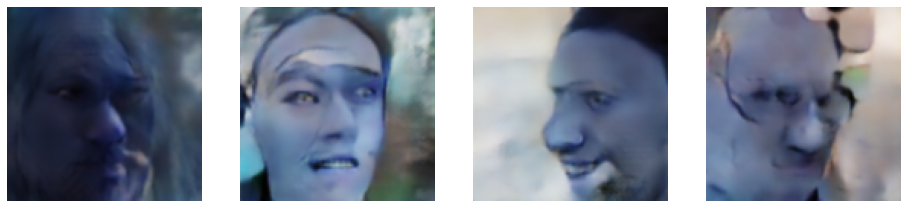

EPOCH: 83


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:10<00:00,  1.68batch/s]


Reconstruction loss: 0.03882453963160515, Adversarial Generator loss: 2.981759548187256, Cycle loss: 0.022232163697481155, Diversity loss: 0.08934164047241211, Discriminator loss: 0.4145919680595398


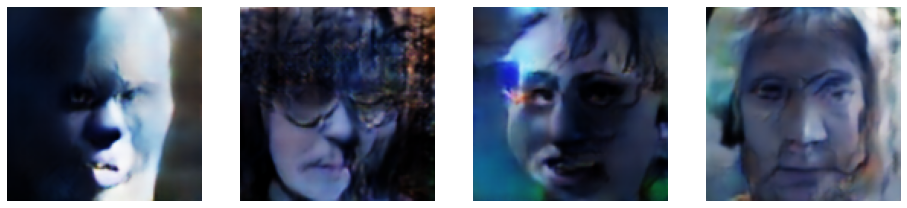

EPOCH: 84


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.03703249618411064, Adversarial Generator loss: 3.089359760284424, Cycle loss: 0.022427180781960487, Diversity loss: 0.08933158963918686, Discriminator loss: 0.39735493063926697


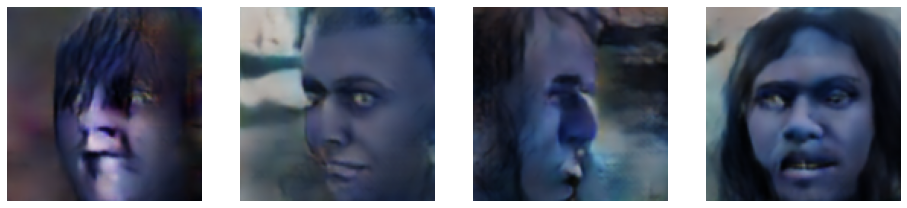

EPOCH: 85


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:10<00:00,  1.68batch/s]


Reconstruction loss: 0.03736814856529236, Adversarial Generator loss: 3.125312328338623, Cycle loss: 0.022680293768644333, Diversity loss: 0.09001696109771729, Discriminator loss: 0.40326207876205444


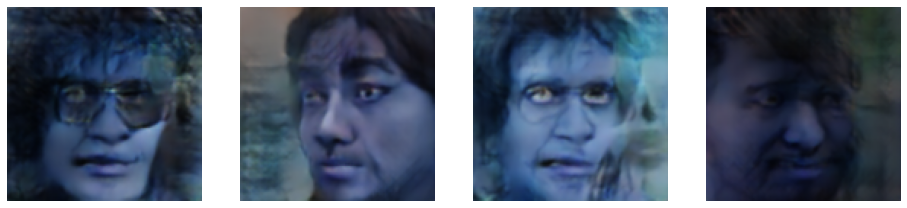

EPOCH: 86


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.69batch/s]


Reconstruction loss: 0.036877814680337906, Adversarial Generator loss: 3.045609712600708, Cycle loss: 0.022114453837275505, Diversity loss: 0.08975017815828323, Discriminator loss: 0.39428016543388367


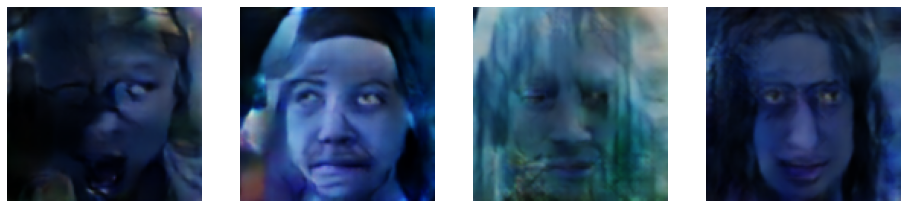

EPOCH: 87


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.03868339583277702, Adversarial Generator loss: 3.0290632247924805, Cycle loss: 0.021970201283693314, Diversity loss: 0.08863845467567444, Discriminator loss: 0.41042560338974


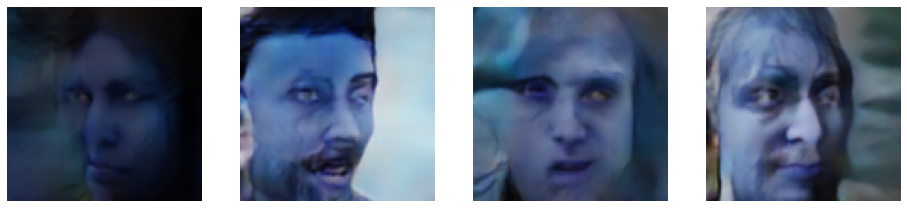

EPOCH: 88


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.70batch/s]


Reconstruction loss: 0.036232445389032364, Adversarial Generator loss: 3.1030497550964355, Cycle loss: 0.02169467695057392, Diversity loss: 0.0924392119050026, Discriminator loss: 0.39021235704421997


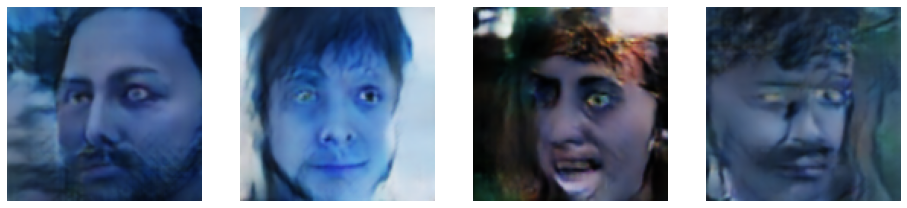

EPOCH: 89


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.037309158593416214, Adversarial Generator loss: 3.1442787647247314, Cycle loss: 0.022317059338092804, Diversity loss: 0.09066762030124664, Discriminator loss: 0.3891710937023163


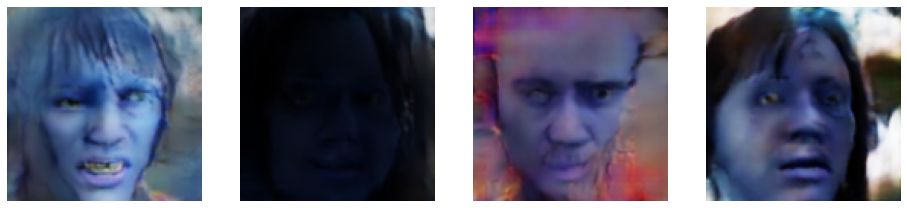

EPOCH: 90


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.03714055195450783, Adversarial Generator loss: 3.088487386703491, Cycle loss: 0.021690163761377335, Diversity loss: 0.09271969646215439, Discriminator loss: 0.4055542051792145


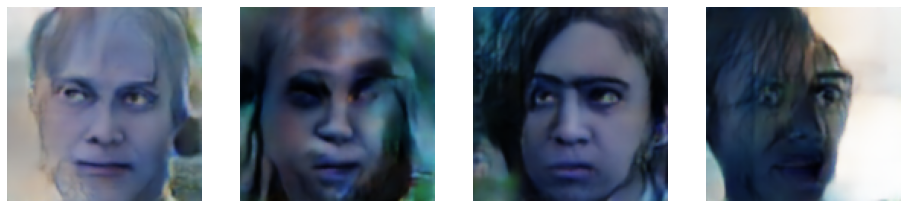

EPOCH: 91


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.03693521022796631, Adversarial Generator loss: 3.1207377910614014, Cycle loss: 0.021683339029550552, Diversity loss: 0.09144488722085953, Discriminator loss: 0.3818078637123108


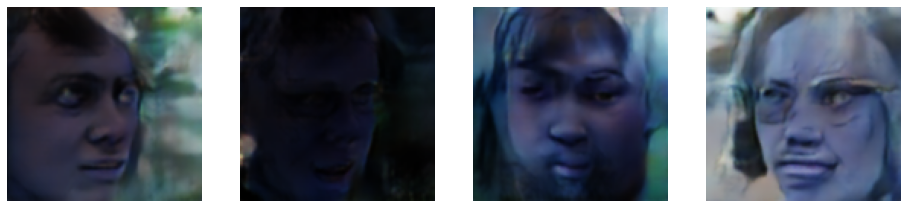

EPOCH: 92


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:09<00:00,  1.68batch/s]


Reconstruction loss: 0.03866897523403168, Adversarial Generator loss: 3.028978109359741, Cycle loss: 0.02155139297246933, Diversity loss: 0.0887785404920578, Discriminator loss: 0.39888572692871094


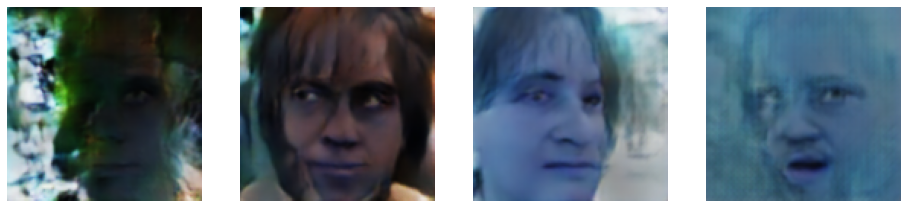

EPOCH: 93


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.70batch/s]


Reconstruction loss: 0.03918885439634323, Adversarial Generator loss: 3.0556256771087646, Cycle loss: 0.02089674025774002, Diversity loss: 0.08936624974012375, Discriminator loss: 0.3998878300189972


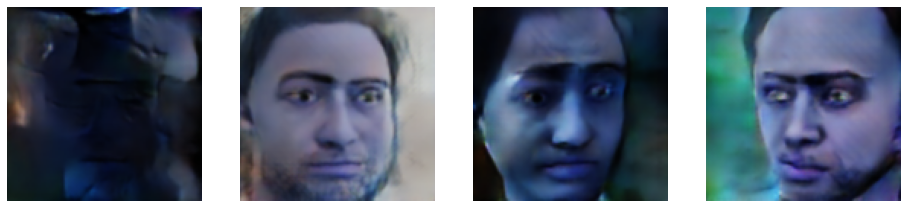

EPOCH: 94


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.69batch/s]


Reconstruction loss: 0.037583883851766586, Adversarial Generator loss: 2.9971394538879395, Cycle loss: 0.02080577425658703, Diversity loss: 0.0904267206788063, Discriminator loss: 0.41756805777549744


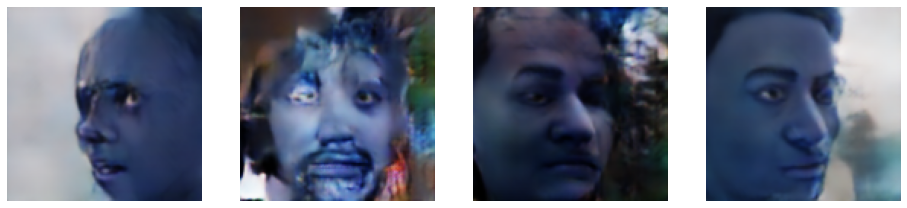

EPOCH: 95


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:06<00:00,  1.70batch/s]


Reconstruction loss: 0.03791463375091553, Adversarial Generator loss: 3.007383108139038, Cycle loss: 0.02128158137202263, Diversity loss: 0.08841203898191452, Discriminator loss: 0.39913320541381836


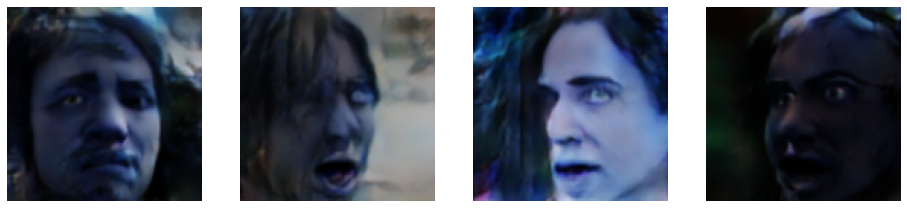

EPOCH: 96


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.037858057767152786, Adversarial Generator loss: 3.07038950920105, Cycle loss: 0.020646056160330772, Diversity loss: 0.08845797926187515, Discriminator loss: 0.40649330615997314


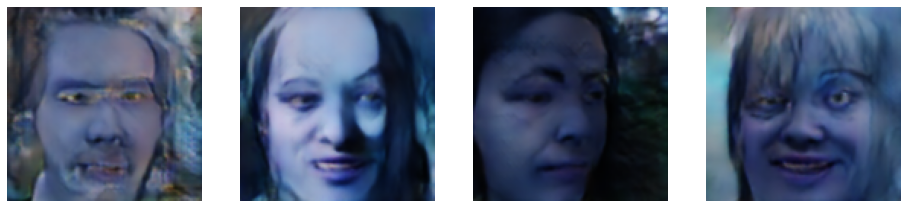

EPOCH: 97


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.037594422698020935, Adversarial Generator loss: 3.0766794681549072, Cycle loss: 0.021282069385051727, Diversity loss: 0.09087299555540085, Discriminator loss: 0.4038848578929901


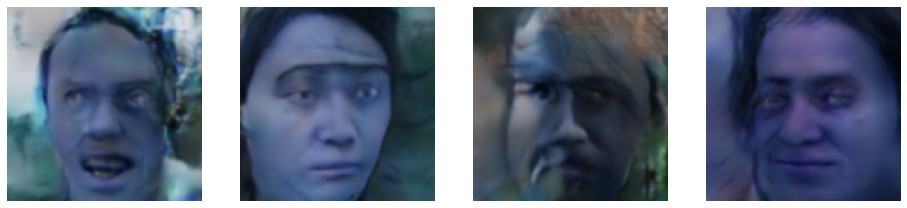

EPOCH: 98


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.038824662566185, Adversarial Generator loss: 2.9601433277130127, Cycle loss: 0.021355561912059784, Diversity loss: 0.09055612981319427, Discriminator loss: 0.41493451595306396


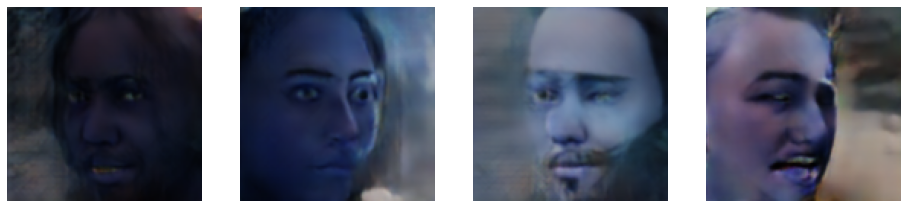

EPOCH: 99


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:07<00:00,  1.70batch/s]


Reconstruction loss: 0.03855866193771362, Adversarial Generator loss: 3.05924654006958, Cycle loss: 0.021636517718434334, Diversity loss: 0.09018722921609879, Discriminator loss: 0.4123867154121399


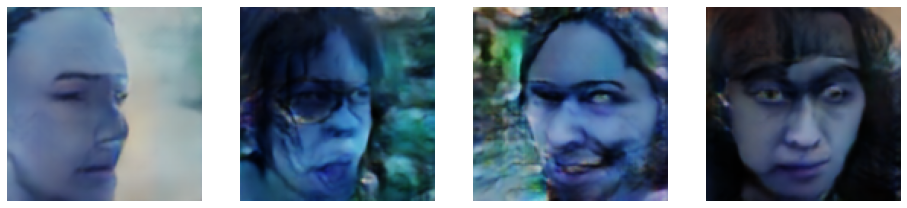

EPOCH: 100


100%|███████████████████████████████████████████████████████████████████████████████████████| 521/521 [05:08<00:00,  1.69batch/s]


Reconstruction loss: 0.03635912761092186, Adversarial Generator loss: 3.12034273147583, Cycle loss: 0.021539444103837013, Diversity loss: 0.08951972424983978, Discriminator loss: 0.3931122422218323


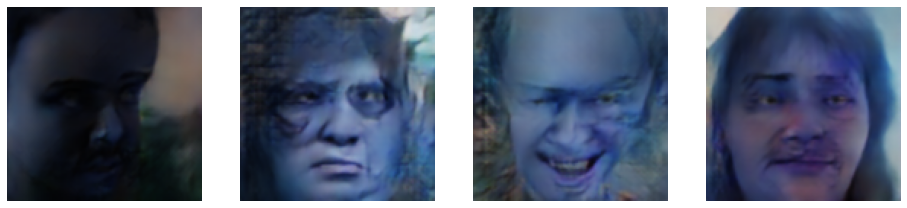

In [5]:
import torch
from tqdm import tqdm

# Assuming EPOCHS and train_dataloader are defined somewhere above

for epoch in range(EPOCHS):
    tot_gen_loss = 0
    tot_discriminator_loss = 0
    tot_div_loss = 0
    tot_dis_loss = 0
    tot_cycle_loss = 0
    print(f"EPOCH: {epoch+1}" )
    with tqdm(train_dataloader, unit="batch") as tepoch:
        for data in tepoch:

            gen_recloss, discriminator_loss, cycle_loss, diversity_loss, output = train_gen(gen_model=generator, 
                                                                disc_model=discriminator, 
                                                                input_img=data, optimizer=gen_optimizer)
            
            dis_loss = train_disc(gen_model=generator, 
                                        disc_model=discriminator,
                                        input_img=data,
                                        optimizer=disc_optimizer)
            tot_gen_loss += gen_recloss
            tot_discriminator_loss += discriminator_loss
            tot_div_loss += diversity_loss
            tot_dis_loss += dis_loss
            tot_cycle_loss += cycle_loss
            # Visualize output if needed
            # visualize_output(output)
        
        avg_gen_loss = tot_gen_loss / len(train_dataloader)
        avg_discriminator_loss = tot_discriminator_loss / len(train_dataloader)
        avg_div_loss = tot_div_loss / len(train_dataloader)
        avg_dis_loss = tot_dis_loss / len(train_dataloader)
        avg_cycle_loss = tot_cycle_loss/len(train_dataloader)
        print(f"Reconstruction loss: {avg_gen_loss}, Adversarial Generator loss: {avg_discriminator_loss}, Cycle loss: {avg_cycle_loss}, Diversity loss: {avg_div_loss}, Discriminator loss: {avg_dis_loss}")
        
        # Visualize the last output of the epoch
        visualize_output(output)

# Save the models after training
    torch.save(generator.state_dict(), "/DATA/shrestha/midsem_project/P1_dataset_training/model_saved/face_gan_2.pth")
    torch.save(discriminator.state_dict(), "/DATA/shrestha/midsem_project/P1_dataset_training/model_saved/discriminator_2.pth")
